In [1]:
from netCDF4 import Dataset
import matplotlib.pyplot as plt
from matplotlib.cm import get_cmap
from mpl_toolkits.basemap import Basemap
import numpy as np
import matplotlib as mpl

from wrf import to_np, getvar, smooth2d, get_basemap, latlon_coords, interplevel

C:\Users\WIN 10\Anaconda3\lib\site-packages\dask\config.py:168: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  data = yaml.load(f.read()) or {}
C:\Users\WIN 10\Anaconda3\lib\site-packages\distributed\config.py:20: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  defaults = yaml.load(f)
C:\Users\WIN 10\Anaconda3\lib\site-packages\distributed\utils.py:134: RuntimeWarning: Couldn't detect a suitable IP address for reaching '8.8.8.8', defaulting to '127.0.0.1': [WinError 10051] A socket operation was attempted to an unreachable network
  % (host, default, e), RuntimeWarning)


In [2]:
# Open the NetCDF file
ncfile = Dataset("data/wrfoutd01_pbl99")

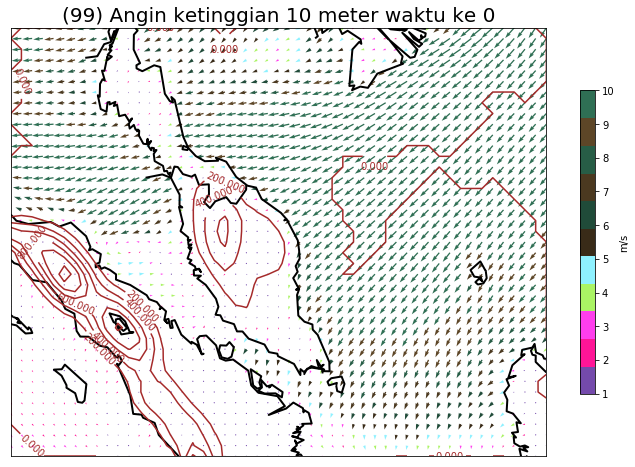

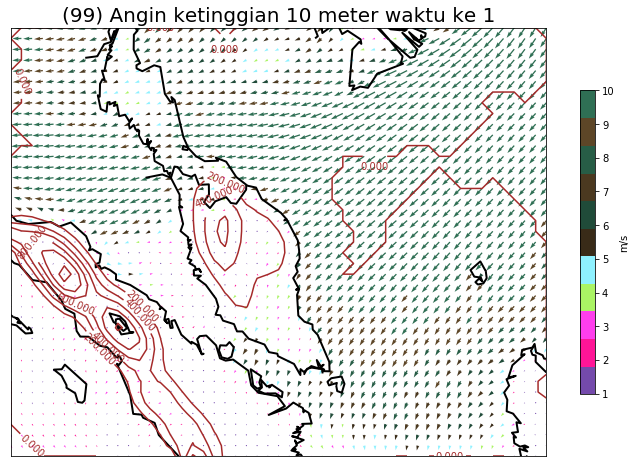

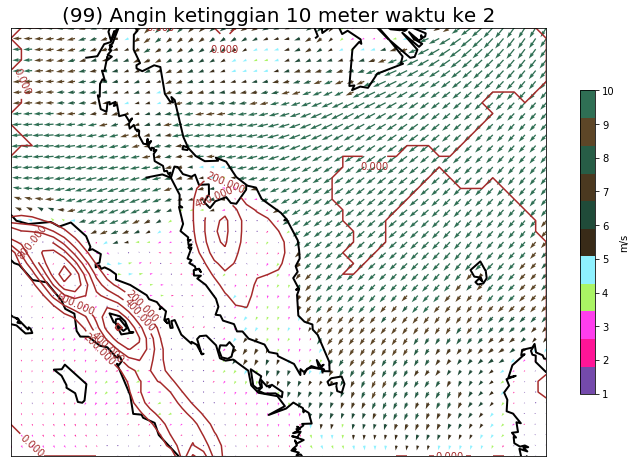

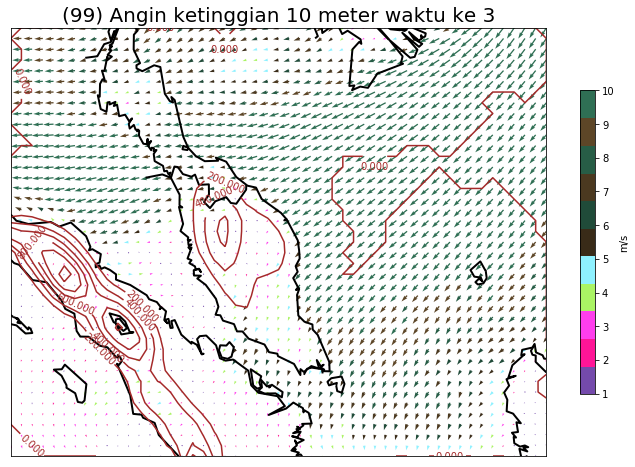

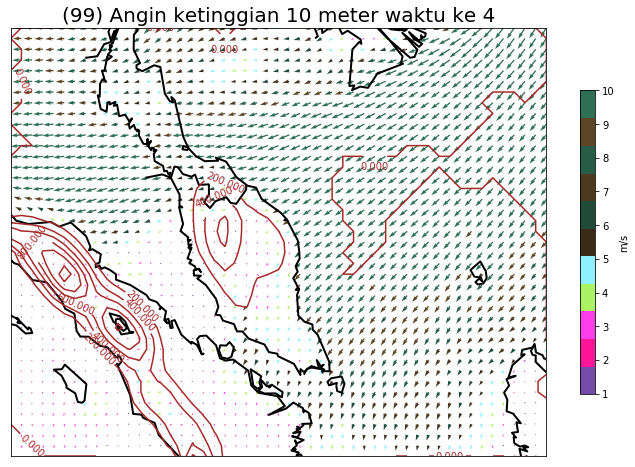

...

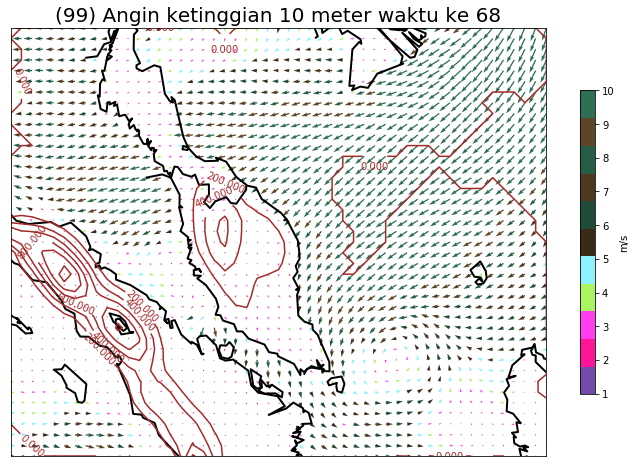

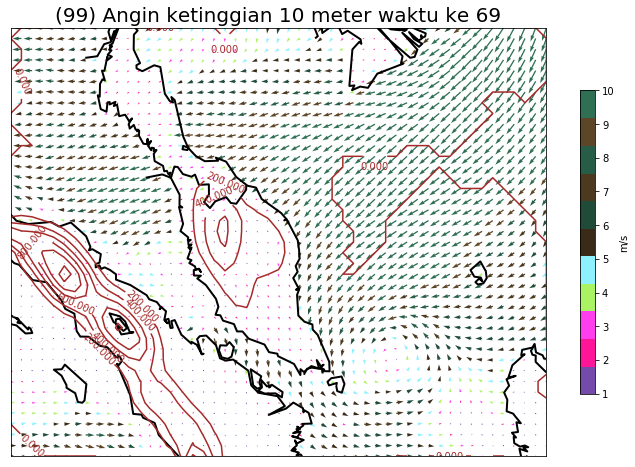

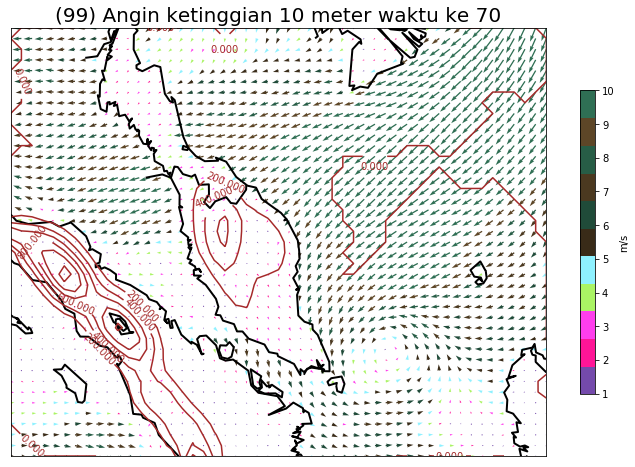

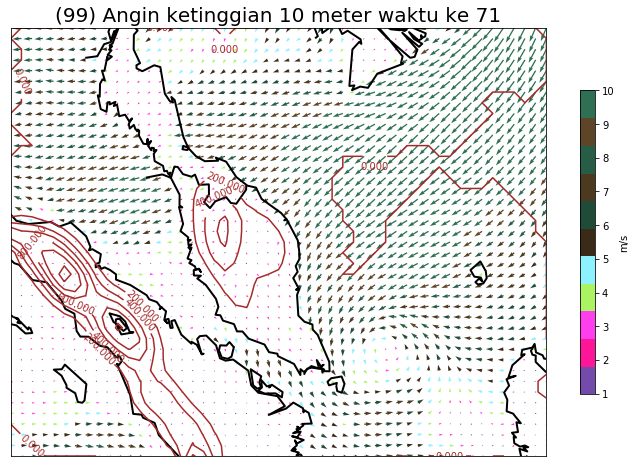

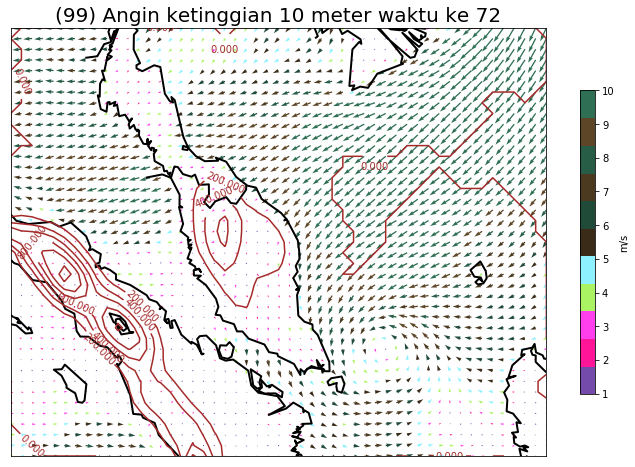

In [3]:
# cmap = mpl.colors.ListedColormap(['#10271d','#392b18','#204b39','#041120','#8c26c2','#fd0000','#1f1ab2','#e3ff00','#ff1597','#ffa500','#aaf464','#8ef1ff'])
cmap = mpl.colors.ListedColormap(['#744aab','#ff1597','#ff3eed','#aaf464','#8ef1ff','#392b18','#204b39','#4b3920','#275d46','#5d4627','#2f6f54'])

for time in range (0,73):
    xx = int(time)
    u = getvar(ncfile, "U10", timeidx=xx)
    v = getvar(ncfile, "V10", timeidx=xx)
    spd=getvar(ncfile, "wspd10",units='m s-1', timeidx=xx)
    hgt = getvar(ncfile, "HGT", timeidx=xx)
    
    lats, lons = latlon_coords(u)  
    bm = get_basemap(hgt)
    fig = plt.figure(figsize=(12,9))
    smooth_hgt = smooth2d(hgt, 3)

    #bm.drawmapboundary(fill_color='aqua')
    #bm.fillcontinents(color='colar',lake_color='aqua')
    #bm.drawlsmask(land_color='green',ocean_color='green',lakes=True)
    bm.drawcoastlines(color='black',linewidth=2)
    bm.drawstates(linewidth=2)
    bm.drawcountries(linewidth=2)

    x, y = bm(to_np(lons), to_np(lats))

    #[::125,::125]
    CS = bm.contour(x, y, to_np(smooth_hgt), colors="brown")
    plt.clabel(CS, inline=1, fontsize=10)
    #bm.contourf(x, y, to_np(spd), cmap=get_cmap("Blues"))
    bm.quiver(x, y, to_np(u), to_np(v), to_np(spd),clim=[1,10], cmap=cmap)

    plt.title("(99) Angin ketinggian 10 meter waktu ke " + str(xx),fontsize=20)
    plt.colorbar(shrink=.62, label = 'm/s')
    plt.show()

    fig.savefig('plot/wind/wind_d02_99_'+str(xx) +'.png')
